Notebook created in 2024 with the help of Xiaoyang Wei, Phd student at LIPADE, Université Paris Cité

# Interacting with CLIP

This is a self-contained notebook that shows how to download and run CLIP models, calculate the similarity between arbitrary image and text inputs, and perform zero-shot image classifications.

# Preparation for Colab

Make sure you're running a GPU runtime; if not, select "GPU" as the hardware accelerator in Runtime > Change Runtime Type in the menu. The next cells will install the `clip` package and its dependencies, and check if PyTorch 1.7.1 or later is installed.

In [1]:
! pip install ftfy regex tqdm
! pip install git+https://github.com/openai/CLIP.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.6 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-aqy4_dn1
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-aqy4_dn1
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369489 sha256=9a591b29de062afaa6548faaf4cce4d8e0586a7a111e9928786806f160e3dff4
  Stored in directory: /tmp/pip-ephem-wheel-cache-l6dadb2t/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


# Loading the model

`clip.available_models()` will list the names of available CLIP models.

In [2]:
import clip
import numpy as np

clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [3]:
model, preprocess = clip.load("ViT-B/16")
model.cuda().eval()
input_resolution = model.visual.input_resolution
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

100%|████████████████████████████████████████| 335M/335M [00:02<00:00, 122MiB/s]


Model parameters: 149,620,737
Input resolution: 224
Context length: 77
Vocab size: 49408


# Image Preprocessing

We resize the input images and center-crop them to conform with the image resolution that the model expects. Before doing so, we will normalize the pixel intensity using the dataset mean and standard deviation.

The second return value from `clip.load()` contains a torchvision `Transform` that performs this preprocessing.



In [4]:
preprocess

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=True)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x7d9d08fd9e10>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

# Text Preprocessing

We use a case-insensitive tokenizer, which can be invoked using `clip.tokenize()`. By default, the outputs are padded to become 77 tokens long, which is what the CLIP models expects.

In [5]:
clip.tokenize("Hello World!")

tensor([[49406,  3306,  1002,   256, 49407,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0,     0,     0,     0,
             0,     0,     0,     0,     0,     0,     0]], dtype=torch.int32)

# Setting up input images and texts

We are going to feed 8 example natrural/medical images and their textual descriptions to the model, and compare the similarity between the corresponding features.

The tokenizer is case-insensitive, and we can freely give any suitable textual descriptions.

In [6]:
import os
import skimage
import IPython.display
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from collections import OrderedDict
import torch

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


if os.getcwd()=='/content':
    try:
        from google.colab import drive
        base_working_dir = '/content/drive/MyDrive'
        drive.mount('/content/drive')
    except:
        base_working_dir = os.getcwd()
        pass
!mkdir -p drive
!google-drive-ocamlfuse drive
print(base_working_dir)

Mounted at /content/drive
/bin/bash: line 1: google-drive-ocamlfuse: command not found
/content/drive/MyDrive


In [7]:

descriptions = {
    "page": "a page of text about segmentation",
    "chelsea": "a facial photo of a tabby cat",
    "astronaut": "a portrait of an astronaut with the American flag",
    "rocket": "a rocket standing on a launchpad",
    "motorcycle_right": "a red motorcycle standing in a garage",
    "camera": "a person looking at a camera on a tripod",
    "horse": "a black-and-white silhouette of a horse",
    "coffee": "a cup of coffee on a saucer"
}

med_descriptions = {
    "ROCO_00002": "CT scan in axial view showing obliteration of the left maxillary sinus",
    "ROCO_00017": "Coronary angiogram demonstrating occluded arteries",
    "ROCO_00028": "T2 weighted MRI image showing foraminal extensions of the cysts",
    "ROCO_00033": "Lytic lesions (arrows) involving the humerus.",
    "ROCO_00050": "Free air beneath the diaphragm at abdominal x-ray film",
    "ROCO_00056": "View of giant cell tumor of thumb metacarpal preoperatively",
    "ROCO_00060": "Transverse view of lung using CT.Leukemic infiltration is seen.",
    "ROCO_00135": "CT scan showing multiple non-communicating cysts in liver and kidney"
}

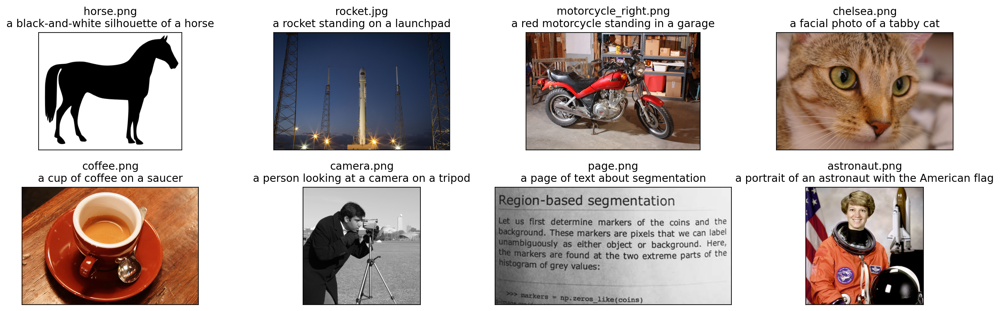

In [8]:
original_images = []
images = []
texts = []
plt.figure(figsize=(16, 5))

skimage.data.download_all(directory=None)
for filename in [filename for filename in os.listdir(skimage.data_dir) if filename.endswith(".png") or filename.endswith(".jpg")]:
    name = os.path.splitext(filename)[0]
    if name not in descriptions:
        continue

    image = Image.open(os.path.join(skimage.data_dir, filename)).convert("RGB")

    plt.subplot(2, 4, len(images) + 1)
    plt.imshow(image)
    plt.title(f"{filename}\n{descriptions[name]}")
    plt.xticks([])
    plt.yticks([])

    original_images.append(image)
    images.append(preprocess(image))
    texts.append(descriptions[name])

plt.tight_layout()


## Building features

We normalize the images, tokenize each text input, and run the forward pass of the model to get the image and text features.

In [9]:
image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

## Calculating cosine similarity

We normalize the features and calculate the dot product of each pair.

Text(0.5, 1.0, 'Cosine similarity between text and image features(natural)')

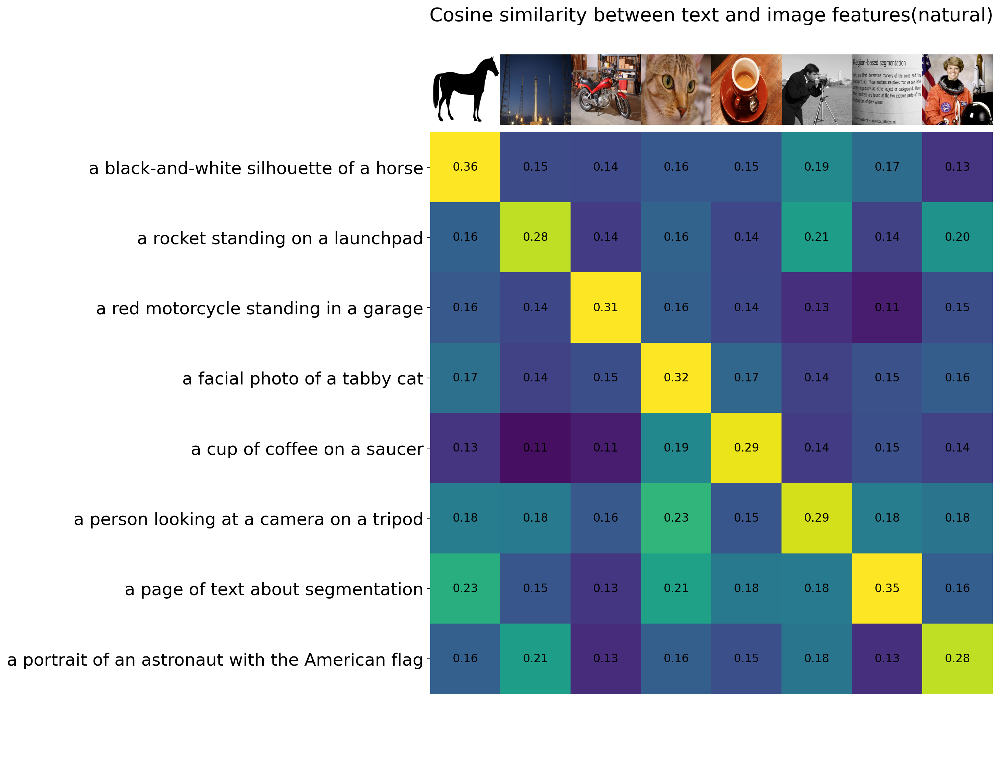

In [10]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)

plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features(natural)", size=20)

## Performance of CLIP in medical domain

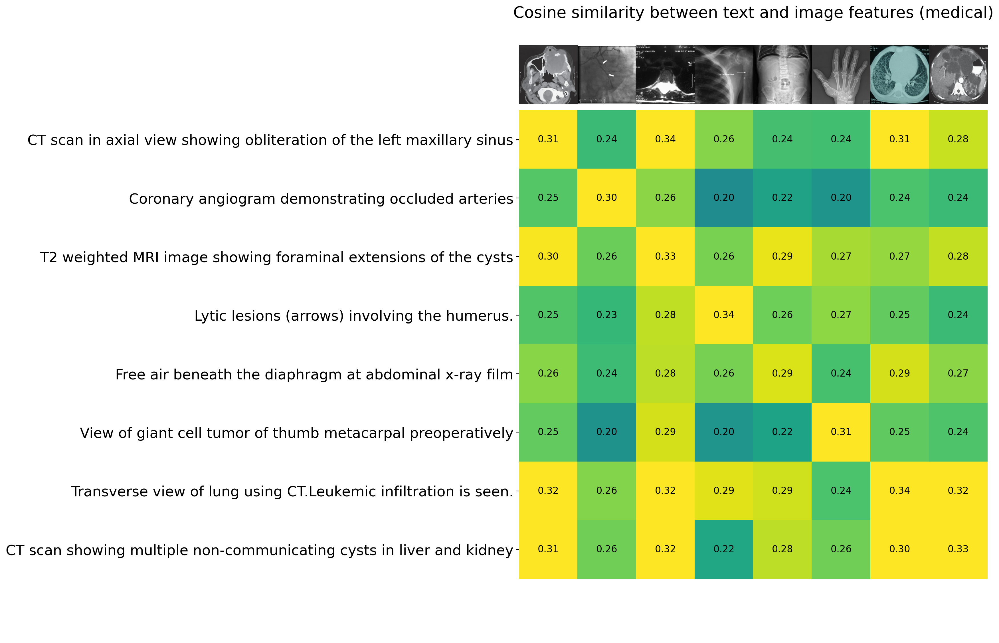

In [23]:
from PIL import Image
import os
import torch
import numpy as np
import matplotlib.pyplot as plt

data_path = "/content/drive/MyDrive/data/data/pretrain_data/roco/train/radiology/images"

original_images = []
images = []
texts = []

for filename in list(med_descriptions.keys()):
    image_path = os.path.join(data_path, filename + '.jpg')
    if os.path.exists(image_path):
        try:
            image = Image.open(image_path).convert("RGB")
            original_images.append(image)
            images.append(preprocess(image))
            texts.append(med_descriptions[filename])
        except Exception as e:
            print(f"❌ Erreur lors du chargement de l'image {filename}: {e}")
    else:
        print(f"❌ Image introuvable : {image_path}")

image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)

similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

count = len(texts)
plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])

for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")

for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
    plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])
plt.title("Cosine similarity between text and image features (medical)", size=20)
plt.show()


# Zero-Shot Image Classification

You can classify images using the cosine similarity (times 100) as the logits to the softmax operation.

In [24]:
from torchvision.datasets import CIFAR100

cifar100 = CIFAR100(os.path.expanduser("~/.cache"), transform=preprocess, download=True)

100%|██████████| 169M/169M [00:12<00:00, 13.4MB/s]


Extracting /root/.cache/cifar-100-python.tar.gz to /root/.cache


In [25]:
text_descriptions = [f"This is a photo of a {label}" for label in cifar100.classes]
text_tokens = clip.tokenize(text_descriptions).cuda()

In [26]:
with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

text_probs = (100.0 * image_features @ text_features.T).softmax(dim=-1)
top_probs, top_labels = text_probs.cpu().topk(5, dim=-1)

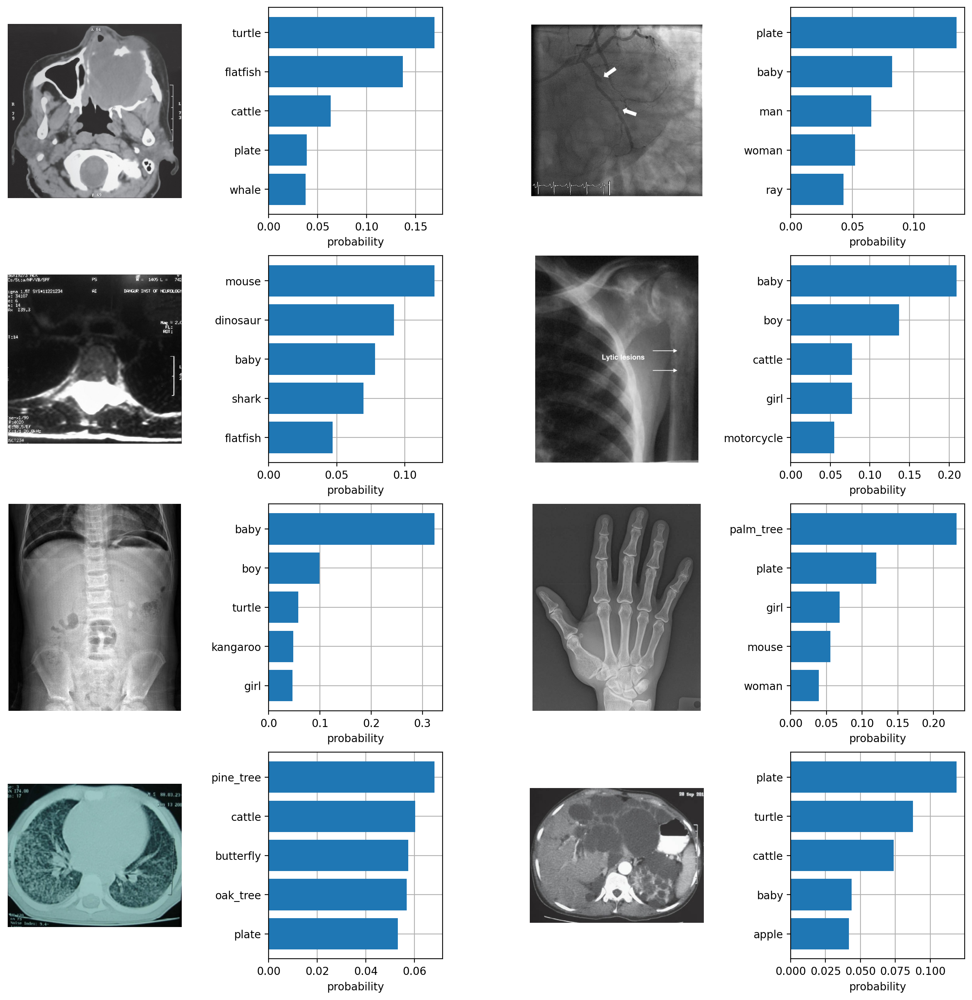

In [27]:
plt.figure(figsize=(16, 16))

for i, image in enumerate(original_images):
    plt.subplot(4, 4, 2 * i + 1)
    plt.imshow(image)
    plt.axis("off")

    plt.subplot(4, 4, 2 * i + 2)
    y = np.arange(top_probs.shape[-1])
    plt.grid()
    plt.barh(y, top_probs[i])
    plt.gca().invert_yaxis()
    plt.gca().set_axisbelow(True)
    plt.yticks(y, [cifar100.classes[index] for index in top_labels[i].numpy()])
    plt.xlabel("probability")

plt.subplots_adjust(wspace=0.5)
plt.show()

# Fine-tuning CLIP on ROCO



In [28]:

csv_file ="/content/drive/My Drive/data/data/roco-list.csv"
root_dir = "/content/drive/My Drive/data/data/pretrain_data/roco/train/radiology/images"
val_csv_file = "/content/drive/My Drive/data/data/local-val-list.csv"
val_root_dir = "/content/drive/My Drive/data/data/pretrain_data/roco/val/radiology/images"

seed = 42
batch_size = 16
image_size = 224
start_epoch = 0
epochs = 10
visual_encoder = "clip@ViT-B/16"
learning_rate = 3e-6
model_path = "/content/drive/My Drive/model_checkpoint_CLIP_ROCO"

In [29]:
import os
import numpy as np
import pandas as pd
import torch
import torchvision
import datetime
import time
from tqdm import tqdm
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
from torch.utils.data import Dataset
import random
import clip



class CLRDataset(Dataset):
    """Contrastive Learning Representations Dataset."""

    def __init__(self, csv_file, root_dir, transform=None, clip=False):
        self.clr_frame = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform
        self.clip = clip

    def __len__(self):
        return len(self.clr_frame)

    def text_sampling(self, text):
        text = text.replace("\n", " ")
        text = text.split(".")
        if '' in text:
            text.remove('')
        text = random.choice(text)
        return text

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = os.path.join(self.root_dir,
                                self.clr_frame.iloc[idx, 0]
                                )
        if not os.path.exists(img_name):
            img_name=img_name.replace('train','val')
        image = Image.open(img_name)
        if not self.clip:
            image = image.convert('RGB')
        text = self.clr_frame.iloc[idx, 1]
        name = self.clr_frame.iloc[idx, 0]
        sample = {'image': image, 'text': text,'name':name}
        if self.clip:
            sample = self.transform(sample['image']), sample['text'],sample['name']
        elif self.transform:
            sample = self.transform(sample)

        return sample


def load_optimizer( model, lr=3e-6):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
        optimizer, epochs, eta_min=0, last_epoch=-1
    )
    return optimizer, scheduler


def train( train_loader, model, tokenizer, optimizer,truncation):
    loss_epoch = 0
    for step, (images, texts,name) in enumerate(train_loader):
        optimizer.zero_grad()
        x_v = images.to('cuda')
        x_u = tokenizer(list(texts), truncate=True).to('cuda')

        v,u=model(x_v,x_u)

        labels = torch.arange(batch_size, dtype=torch.long, device='cuda')

        loss_img = torch.nn.CrossEntropyLoss()
        loss_txt = torch.nn.CrossEntropyLoss()

        img_loss = loss_img(v,labels)
        text_loss = loss_txt(u,labels)

        loss = (img_loss + text_loss)/2

        loss.backward()
        optimizer.step()

        if step % 500 == 0:
            print(f"Step [{step}/{len(train_loader)}]\t Loss: {loss.item()}")

        loss_epoch += loss.item()
    return loss_epoch



def validate( val_loader, model, tokenizer, optimizer, truncation):

    with torch.no_grad():
        model.eval()
        loss_epoch = 0
        for step, (x_v, x_u) in enumerate(val_loader):
            x_v = x_v.to('cuda')
            x_u = tokenizer(list(x_u), truncate=True).to('cuda')

            v,u=model(x_v,x_u)

            labels = torch.arange(batch_size, dtype=torch.long, device='cuda')

            loss_img = torch.nn.CrossEntropyLoss()
            loss_txt = torch.nn.CrossEntropyLoss()

            img_loss = loss_img(v,labels)
            text_loss = loss_txt(u,labels)

            loss = (img_loss + text_loss)/2
            loss_epoch += loss.item()

    model.train()
    return loss_epoch


def main(gpu):

    is_master=True

    torch.cuda.set_device(gpu)
    torch.manual_seed(seed)
    np.random.seed(seed)

    print("Initializing model... ", end="", flush=True)
    model, preprocess = clip.load(visual_encoder.split("@")[-1], device='cuda', jit=False)
    model.float()
    tokenizer=clip.tokenize
    train_fonction = train
    validate_fonction = validate

    optimizer, scheduler = load_optimizer(model, lr=float(learning_rate))

    transform = preprocess
    print('Image_Transform',transform)
    train_dataset = CLRDataset(csv_file=csv_file,
                               root_dir=root_dir,
                               transform=transform,
                               clip = True
                               )

    val_dataset = CLRDataset(csv_file=val_csv_file,
                             root_dir=val_root_dir,
                             transform=transform,
                             clip = True
                             )

    train_sampler = None
    train_loader = torch.utils.data.DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=(train_sampler is None),
        drop_last=True,
        num_workers=8,
        sampler=train_sampler,
    )

    val_loader = torch.utils.data.DataLoader(
        val_dataset,
        batch_size=batch_size,
        drop_last=True,
        num_workers=8
    )

    print("[DONE]\n")
    print("STARTING TRAINING")
    print('Start Time =', datetime.datetime.now().strftime("%H:%M:%S"), '\n')

    t0 = time.time()
    global_step = 0
    current_epoch = 0
    best_val_loss = np.inf

    for epoch in range(0, epochs):
        if epoch<2:
            if train_sampler is not None:
                train_sampler.set_epoch(epoch)

            lr = optimizer.param_groups[0]["lr"]
            loss_epoch = train_fonction(train_loader, model, tokenizer, optimizer,True)

        if is_master:
            val_loss = validate_fonction( val_loader, model, tokenizer, optimizer, True)
            if val_loss < best_val_loss:
                torch.save(model.state_dict(), os.path.join(model_path, "best_checkpoint.pth"))
                best_val_loss = val_loss

            epoch_counter = epoch - 0
            elapsed = time.time() - t0
            epoch_time = elapsed/(epoch_counter+1)
            remaining = (epochs - (epoch_counter+1))*epoch_time
            remaining = str(datetime.timedelta(seconds=round(remaining)))
            elapsed = str(datetime.timedelta(seconds=round(elapsed)))
            print(f'Epoch {epoch_counter+1}/{epochs} [{elapsed}<{remaining}, {round(epoch_time, 2)}s/epoch] {round((epoch_counter+1)/epochs*100, 1)}% loss: {loss_epoch / len(train_loader)}\t val_loss: {val_loss / len(val_loader)} lr: {lr}')

            current_epoch += 1


if not os.path.exists(model_path):
    os.makedirs(model_path)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Device:", device)
main(0)

Device: cuda:0
Initializing model... Image_Transform Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=True)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x7d9d08fd9e10>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)
[DONE]

STARTING TRAINING
Start Time = 19:09:31 



/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Step [0/4087]	 Loss: 1.6037722826004028
Step [500/4087]	 Loss: 0.982514500617981
Step [1000/4087]	 Loss: 1.0173747539520264
Step [1500/4087]	 Loss: 1.0779681205749512
Step [2000/4087]	 Loss: 0.7830466032028198
Step [2500/4087]	 Loss: 0.7197632789611816
Step [3000/4087]	 Loss: 0.4909234642982483
Step [3500/4087]	 Loss: 0.6283676624298096
Step [4000/4087]	 Loss: 0.3846929669380188


ValueError: too many values to unpack (expected 2)

## Performance of CLIP in medical domain(after fine-tuning on ROCO )

<ipython-input-31-856738be057b>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/My Drive/data/data/ViT-B-16_best_checkpoint

Text(0.5, 1.0, 'Cosine similarity between text and image features(medical)')

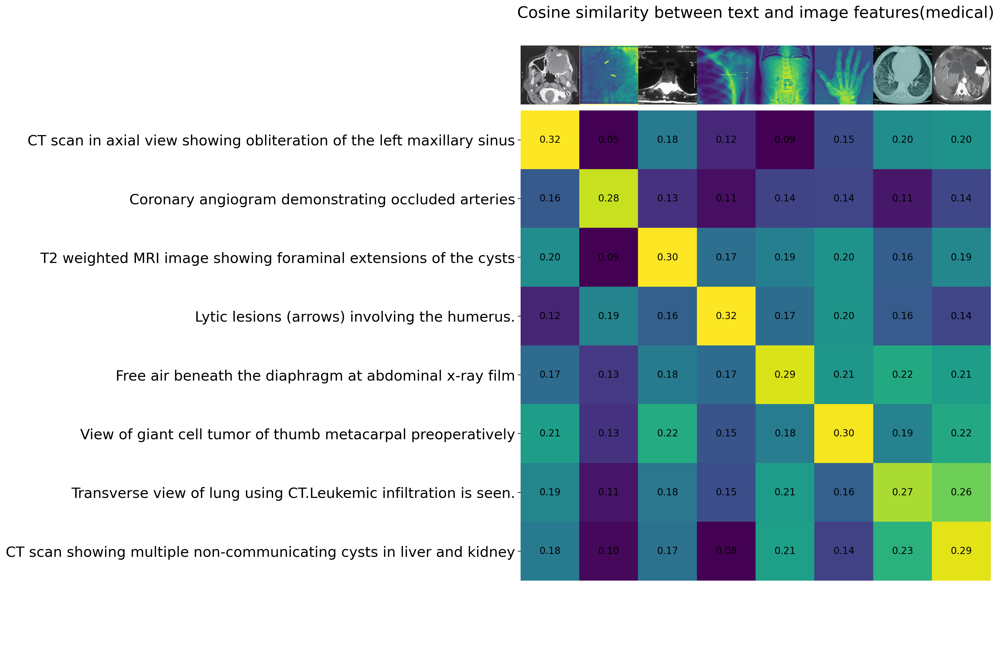

In [31]:

model.load_state_dict(torch.load('/content/drive/My Drive/data/data/ViT-B-16_best_checkpoint_2.tar'))

original_images = []
images = []
texts = []
for filename in list(med_descriptions.keys()):
    image = Image.open(os.path.join(root_dir, filename+'.jpg'))
    original_images.append(image)
    images.append(preprocess(image))
    texts.append(med_descriptions[filename])
image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

count = len(descriptions)

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
plt.yticks(range(count), texts, fontsize=18)
plt.xticks([])
for i, image in enumerate(original_images):
    plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="lower")
for x in range(similarity.shape[1]):
    for y in range(similarity.shape[0]):
        plt.text(x, y, f"{similarity[y, x]:.2f}", ha="center", va="center", size=12)

for side in ["left", "top", "right", "bottom"]:
  plt.gca().spines[side].set_visible(False)

plt.xlim([-0.5, count - 0.5])
plt.ylim([count + 0.5, -2])

plt.title("Cosine similarity between text and image features(medical)", size=20)

# **Comparaison entre les deux modèles  ViT-B/16 et RN50**

In [33]:
import numpy as np
import torch

models_to_compare = ["ViT-B/16", "RN50"]
comparison_results = {}

for model_name in models_to_compare:
    model, preprocess = clip.load(model_name, device='cuda')
    model.eval()
    total_params = np.sum([int(np.prod(p.shape)) for p in model.parameters()])
    input_resolution = model.visual.input_resolution
    context_length = model.context_length
    vocab_size = model.vocab_size

    comparison_results[model_name] = {
        "params": total_params,
        "resolution": input_resolution,
        "context_length": context_length,
        "vocab_size": vocab_size
    }

for model, details in comparison_results.items():
    print(f"Modèle : {model}")
    print(f"Paramètres : {details['params']:,}")
    print(f"Résolution : {details['resolution']}")
    print(f"Longueur du contexte : {details['context_length']}")
    print(f"Taille du vocabulaire : {details['vocab_size']}")


100%|████████████████████████████████████████| 244M/244M [00:01<00:00, 142MiB/s]


Modèle : ViT-B/16
Paramètres : 149,620,737
Résolution : 224
Longueur du contexte : 77
Taille du vocabulaire : 49408
Modèle : RN50
Paramètres : 102,007,137
Résolution : 224
Longueur du contexte : 77
Taille du vocabulaire : 49408


In [34]:
import time
import torch
import clip
import numpy as np
from PIL import Image
import os
models_to_compare = ["ViT-B/16", "RN50"]

comparison_metrics = {}

data_path = "/content/drive/MyDrive/data/data/pretrain_data/roco/train/radiology/images"
med_descriptions = {
    "ROCO_00002": "CT scan in axial view showing obliteration of the left maxillary sinus",
    "ROCO_00017": "Coronary angiogram demonstrating occluded arteries",
}

original_images = []
images = []
texts = []

for filename in list(med_descriptions.keys()):
    image_path = os.path.join(data_path, filename + '.jpg')
    image = Image.open(image_path).convert("RGB")
    original_images.append(image)
    images.append(preprocess(image))
    texts.append(med_descriptions[filename])

image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

for model_name in models_to_compare:
    print(f"\n🔄 Évaluation du modèle : {model_name}")
    model, preprocess = clip.load(model_name, device='cuda')
    model.eval()

    total_params = np.sum([int(np.prod(p.shape)) for p in model.parameters()])

    start_time = time.time()
    with torch.no_grad():
        image_features = model.encode_image(image_input).float()
        text_features = model.encode_text(text_tokens).float()
    inference_time = time.time() - start_time

    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

    avg_similarity = np.mean(similarity)

    comparison_metrics[model_name] = {
        "params": total_params,
        "inference_time": inference_time,
        "avg_similarity": avg_similarity
    }

for model, metrics in comparison_metrics.items():
    print(f"\n📊 Modèle : {model}")
    print(f"Paramètres : {metrics['params']:,}")
    print(f"Temps d'inférence : {metrics['inference_time']:.4f} secondes")
    print(f"Score moyen de similarité : {metrics['avg_similarity']:.4f}")



🔄 Évaluation du modèle : ViT-B/16

🔄 Évaluation du modèle : RN50

📊 Modèle : ViT-B/16
Paramètres : 149,620,737
Temps d'inférence : 0.0340 secondes
Score moyen de similarité : 0.2749

📊 Modèle : RN50
Paramètres : 102,007,137
Temps d'inférence : 0.3212 secondes
Score moyen de similarité : 0.2386


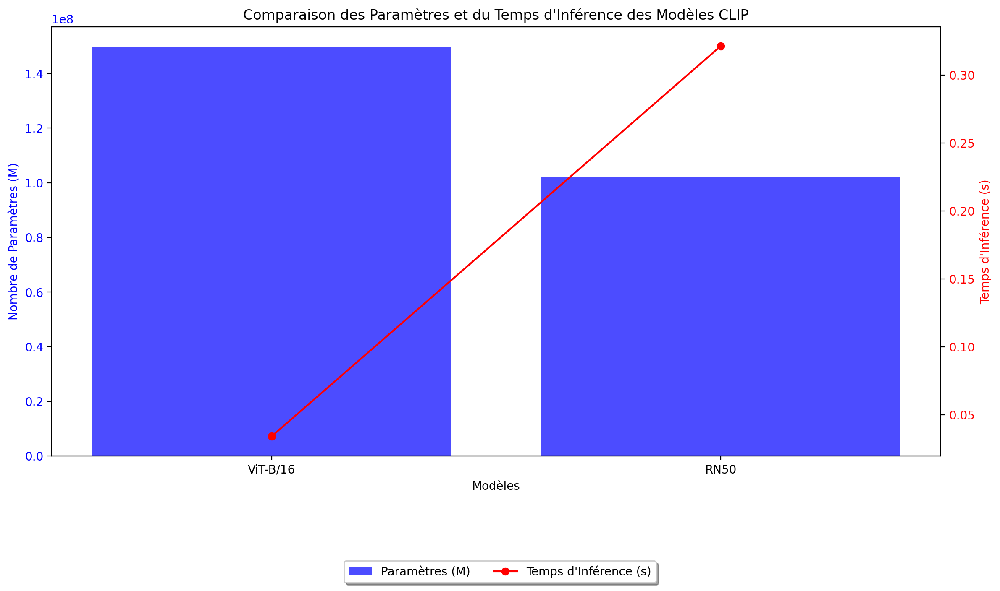

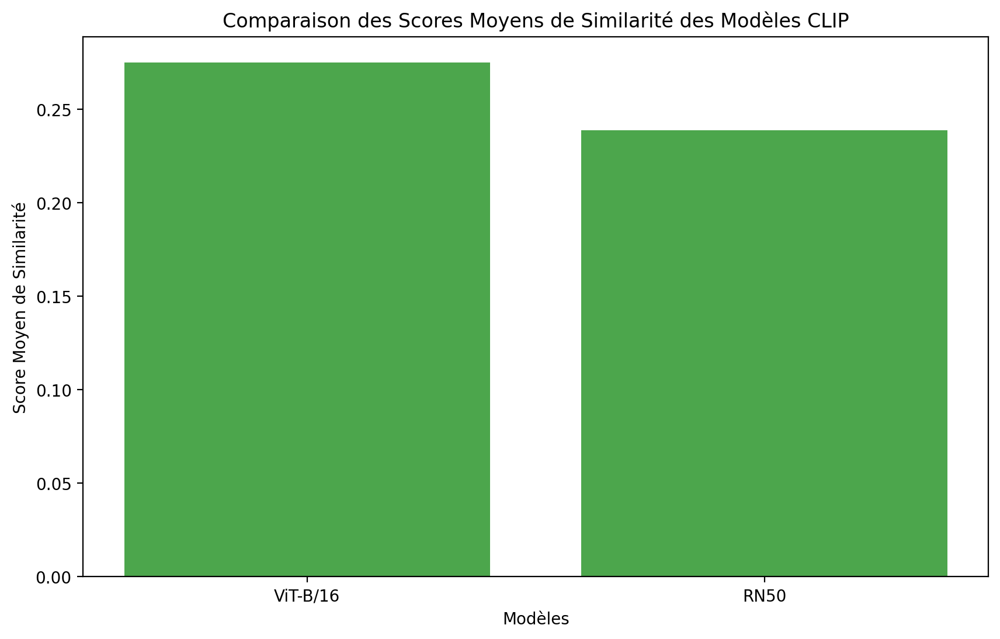

In [35]:
import matplotlib.pyplot as plt

models = list(comparison_metrics.keys())
params = [comparison_metrics[m]['params'] for m in models]
inference_times = [comparison_metrics[m]['inference_time'] for m in models]
avg_similarities = [comparison_metrics[m]['avg_similarity'] for m in models]

fig, ax1 = plt.subplots(figsize=(12, 6))

ax1.bar(models, params, alpha=0.7, label='Paramètres (M)', color='b')
ax1.set_xlabel('Modèles')
ax1.set_ylabel('Nombre de Paramètres (M)', color='b')
ax1.tick_params(axis='y', labelcolor='b')

ax2 = ax1.twinx()
ax2.plot(models, inference_times, marker='o', color='r', label='Temps d\'Inférence (s)')
ax2.set_ylabel('Temps d\'Inférence (s)', color='r')
ax2.tick_params(axis='y', labelcolor='r')

fig.tight_layout()
fig.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=True, shadow=True, ncol=2)
plt.title('Comparaison des Paramètres et du Temps d\'Inférence des Modèles CLIP')
plt.show()

plt.figure(figsize=(10, 6))
plt.bar(models, avg_similarities, color='g', alpha=0.7)
plt.xlabel('Modèles')
plt.ylabel('Score Moyen de Similarité')
plt.title('Comparaison des Scores Moyens de Similarité des Modèles CLIP')
plt.show()


#Résultats sur les Données Médicales

In [37]:
import clip
import torch

model_name = "ViT-B/16"
model, preprocess = clip.load(model_name, device='cuda')
model.eval()


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [38]:
print(type(model))
print(model)


<class 'clip.model.CLIP'>
CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=

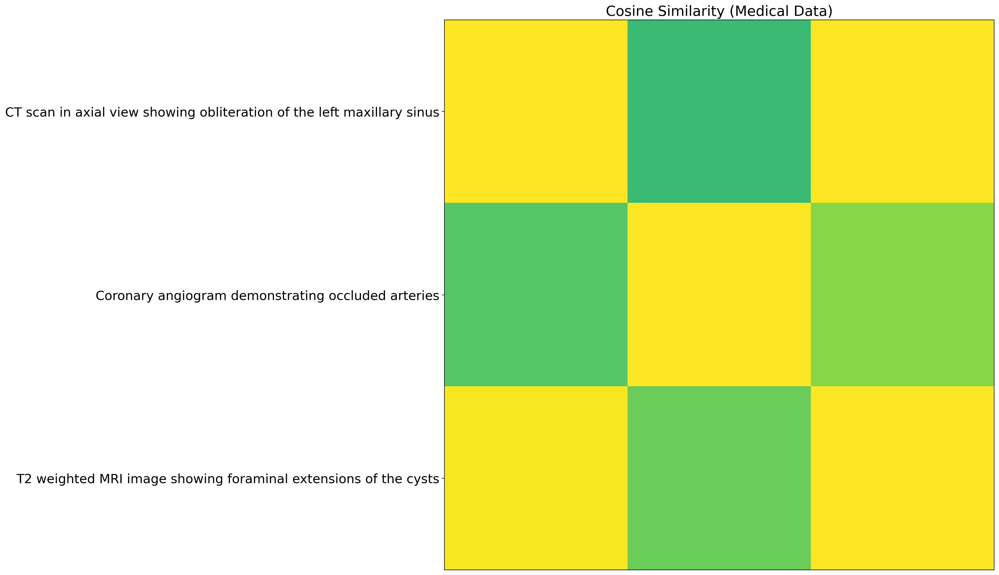

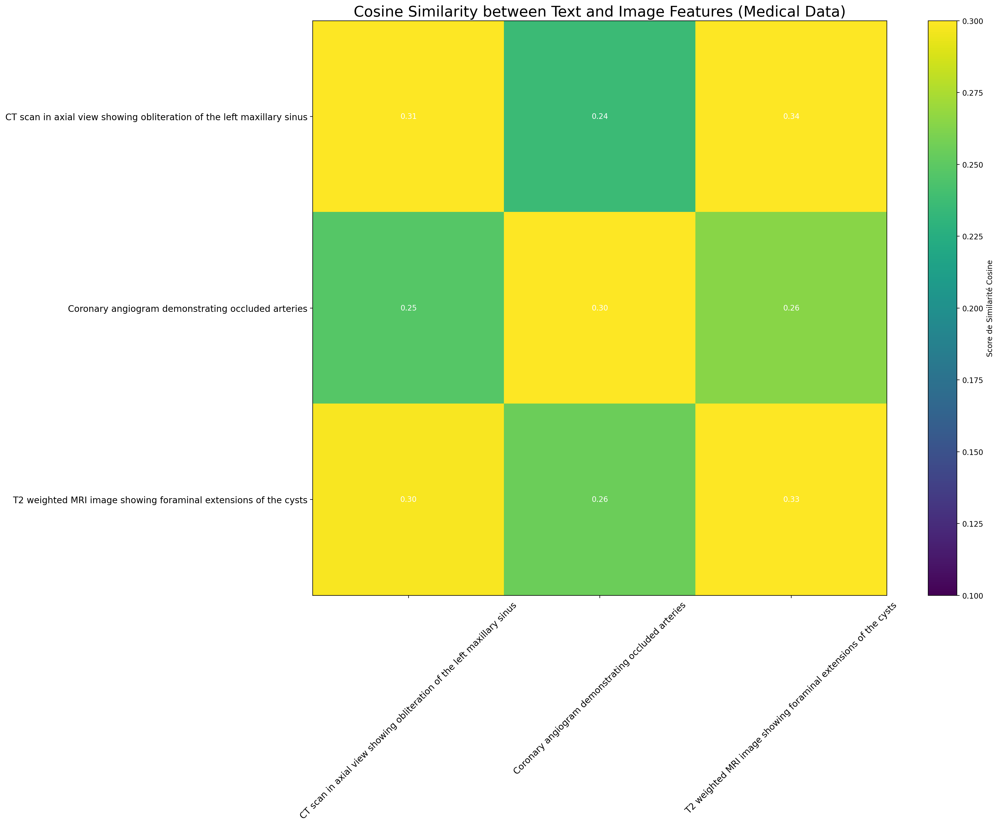

In [40]:
from PIL import Image
import os
import torch
import numpy as np
import matplotlib.pyplot as plt

data_path = "/content/drive/MyDrive/data/data/pretrain_data/roco/train/radiology/images"

med_descriptions = {
    "ROCO_00002": "CT scan in axial view showing obliteration of the left maxillary sinus",
    "ROCO_00017": "Coronary angiogram demonstrating occluded arteries",
    "ROCO_00028": "T2 weighted MRI image showing foraminal extensions of the cysts"
}

original_images = []
images = []
texts = []

for filename in list(med_descriptions.keys()):
    image_path = os.path.join(data_path, filename + '.jpg')
    image = Image.open(image_path).convert("RGB")
    original_images.append(image)
    images.append(preprocess(image))
    texts.append(med_descriptions[filename])

image_input = torch.tensor(np.stack(images)).cuda()
text_tokens = clip.tokenize(["This is " + desc for desc in texts]).cuda()

with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3)
plt.yticks(range(len(texts)), texts, fontsize=18)
plt.xticks([])
plt.title("Cosine Similarity (Medical Data)", size=20)
plt.show()

import matplotlib.pyplot as plt

plt.figure(figsize=(20, 14))
plt.imshow(similarity, vmin=0.1, vmax=0.3, cmap='viridis')
plt.colorbar(label='Score de Similarité Cosine')
plt.yticks(range(len(texts)), texts, fontsize=12)
plt.xticks(range(len(texts)), texts, fontsize=12, rotation=45)
plt.title("Cosine Similarity between Text and Image Features (Medical Data)", size=20)

for i in range(similarity.shape[0]):
    for j in range(similarity.shape[1]):
        plt.text(j, i, f"{similarity[i, j]:.2f}", ha='center', va='center', color='white')

plt.show()



In [41]:

min_similarity_idx = np.unravel_index(np.argmin(similarity, axis=None), similarity.shape)
min_similarity_value = similarity[min_similarity_idx]

print(f"Faible Similarité : Texte {texts[min_similarity_idx[0]]} ↔ Image {list(med_descriptions.keys())[min_similarity_idx[1]]}")
print(f"Score : {min_similarity_value:.2f}")


Faible Similarité : Texte CT scan in axial view showing obliteration of the left maxillary sinus ↔ Image ROCO_00017
Score : 0.24


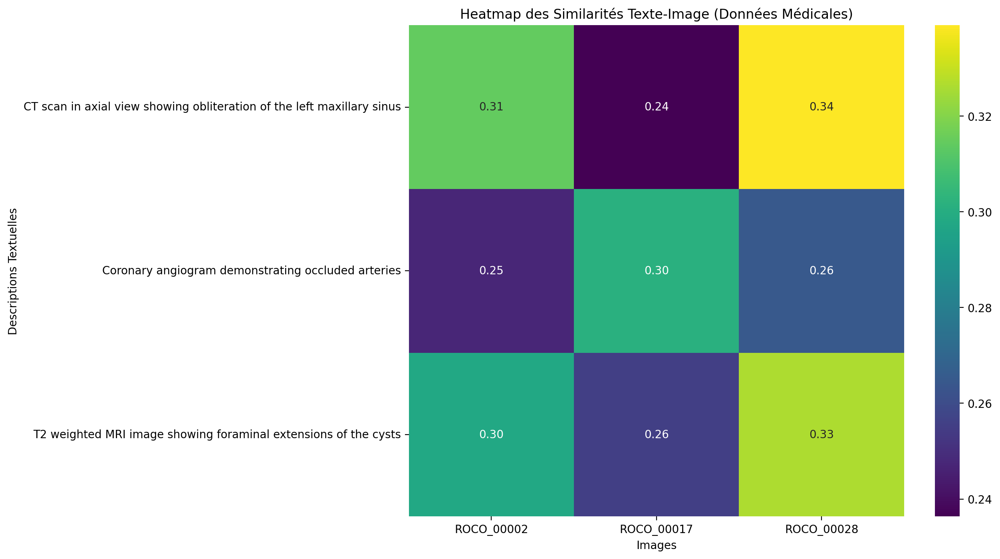

In [42]:
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.heatmap(similarity, annot=True, fmt=".2f", cmap="viridis", xticklabels=list(med_descriptions.keys()), yticklabels=texts)
plt.title("Heatmap des Similarités Texte-Image (Données Médicales)")
plt.xlabel("Images")
plt.ylabel("Descriptions Textuelles")
plt.show()


# Classification sur un Nouveau Jeu de Données: Oxford Flowers102

In [53]:

!wget http://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz -P ~/.cache/flowers-102/
!wget http://www.robots.ox.ac.uk/~vgg/data/flowers/102/imagelabels.mat -P ~/.cache/flowers-102/
!wget http://www.robots.ox.ac.uk/~vgg/data/flowers/102/setid.mat -P ~/.cache/flowers-102/

!tar -xzf ~/.cache/flowers-102/102flowers.tgz -C ~/.cache/flowers-102/


--2024-12-21 22:02:32--  http://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz
Resolving www.robots.ox.ac.uk (www.robots.ox.ac.uk)... 129.67.94.2
Connecting to www.robots.ox.ac.uk (www.robots.ox.ac.uk)|129.67.94.2|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz [following]
--2024-12-21 22:02:33--  https://www.robots.ox.ac.uk/~vgg/data/flowers/102/102flowers.tgz
Connecting to www.robots.ox.ac.uk (www.robots.ox.ac.uk)|129.67.94.2|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://thor.robots.ox.ac.uk/flowers/102/102flowers.tgz [following]
--2024-12-21 22:02:34--  https://thor.robots.ox.ac.uk/flowers/102/102flowers.tgz
Resolving thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)... 129.67.95.98
Connecting to thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)|129.67.95.98|:443... connected.
HTTP request sent, awaiting response... 200 OK
Leng

In [51]:
pip install transformers


In [54]:

flower_classes = {
    0: "pink primrose",
    1: "hard-leaved pocket orchid",
    2: "canterbury bells",
    3: "sweet pea",
    4: "wild geranium",
    5: "tiger lily",
    6: "moon orchid",
    7: "bird of paradise",
    8: "monkshood",
    9: "globe thistle"
}

text_descriptions = [f"This is a photo of a {name}" for _, name in flower_classes.items()]

text_tokens = clip.tokenize(text_descriptions).cuda()


In [55]:

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)

images, labels = [], []
for i in range(16):
    image, label = dataset[i]
    images.append(image)
    labels.append(label)

image_input = torch.tensor(np.stack([img.numpy() for img in images])).cuda()
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    image_features /= image_features.norm(dim=-1, keepdim=True)


In [56]:

similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

print("Matrice de Similarité Texte-Image :")
print(similarity)


Matrice de Similarité Texte-Image :
[[0.31478357 0.31124118 0.30895478 0.35518855 0.3372963  0.31743962
  0.3405441  0.34283513 0.29612944 0.3263675  0.27604115 0.3346942
  0.29220593 0.29374394 0.2796322  0.32394886]
 [0.24601483 0.2093464  0.22550634 0.22711219 0.22329307 0.20505777
  0.20410448 0.24560009 0.21204233 0.22367421 0.22609016 0.2741976
  0.17824876 0.23613076 0.19176385 0.2364461 ]
 [0.2858558  0.27263072 0.29317605 0.28336543 0.29379672 0.2795089
  0.2802918  0.3087647  0.29394585 0.29015523 0.29355514 0.30152303
  0.29796898 0.296807   0.28004122 0.25826403]
 [0.2927506  0.303872   0.25258583 0.27998775 0.28755474 0.30249912
  0.2648165  0.29418182 0.2937639  0.29571712 0.275034   0.29652587
  0.2925731  0.299088   0.24785036 0.2566891 ]
 [0.28407428 0.3114214  0.2942872  0.30892366 0.3155686  0.31624615
  0.30241448 0.32163355 0.31940433 0.318708   0.2929566  0.33405387
  0.30795345 0.2816966  0.29365543 0.29082876]
 [0.21735686 0.23832771 0.23045914 0.20098749 0.2486

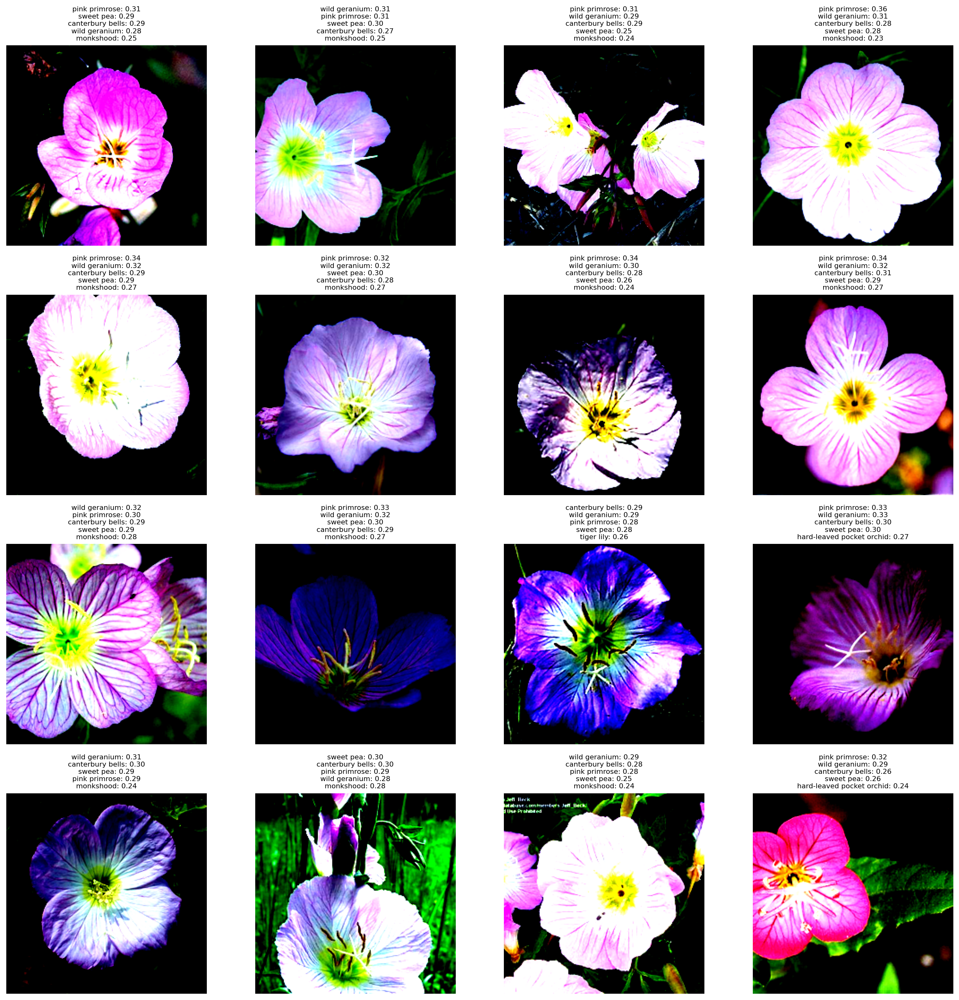

In [57]:

import matplotlib.pyplot as plt

plt.figure(figsize=(16, 16))
for i, image in enumerate(images):
    plt.subplot(4, 4, i + 1)
    plt.imshow(image.permute(1, 2, 0))
    plt.axis("off")

    top_probs = similarity[:, i].argsort()[-5:][::-1]
    title = "\n".join([f"{flower_classes[label]}: {similarity[label, i]:.2f}" for label in top_probs])
    plt.title(title, fontsize=8)

plt.tight_layout()
plt.show()


In [59]:

model, preprocess = clip.load("ViT-L/14", device='cuda')
model.eval()


100%|███████████████████████████████████████| 890M/890M [00:12<00:00, 77.4MiB/s]


CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 1024, kernel_size=(14, 14), stride=(14, 14), bias=False)
    (ln_pre): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=1024, out_features=1024, bias=True)
          )
          (ln_1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=1024, out_features=4096, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=4096, out_features=1024, bias=True)
          )
          (ln_2): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=1024, out_features=1024, bias=True)


In [65]:

import torch
import clip
from torchvision.datasets import Flowers102
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/16", device=device)
model.eval()

flower_classes = {
    0: "pink primrose",
    1: "hard-leaved pocket orchid",
    2: "canterbury bells",
    3: "sweet pea",
    4: "wild geranium",
    5: "tiger lily",
    6: "moon orchid",
    7: "bird of paradise",
    8: "monkshood",
    9: "globe thistle"
}

text_descriptions = [f"This is a photo of a {name}" for name in flower_classes.values()]
text_tokens = clip.tokenize(text_descriptions).to(device)

with torch.no_grad():
    text_features = model.encode_text(text_tokens).float()
    text_features /= text_features.norm(dim=-1, keepdim=True)
print(f"✅ Dimensions des caractéristiques texte : {text_features.shape}")


✅ Dimensions des caractéristiques texte : torch.Size([10, 512])


In [66]:

from torchvision.datasets import Flowers102

dataset = Flowers102(root='~/.cache', split='test', transform=preprocess, download=True)

images, labels = [], []
for i in range(16):
    image, label = dataset[i]
    images.append(image)
    labels.append(label)

image_input = torch.stack(images).to(device)

with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    image_features /= image_features.norm(dim=-1, keepdim=True)
print(f"✅ Dimensions des caractéristiques image : {image_features.shape}")


✅ Dimensions des caractéristiques image : torch.Size([16, 512])


In [68]:

with torch.no_grad():
    similarity = (text_features @ image_features.T).cpu().numpy()

print(f" Dimensions de la matrice de similarité : {similarity.shape}")


 Dimensions de la matrice de similarité : (10, 16)


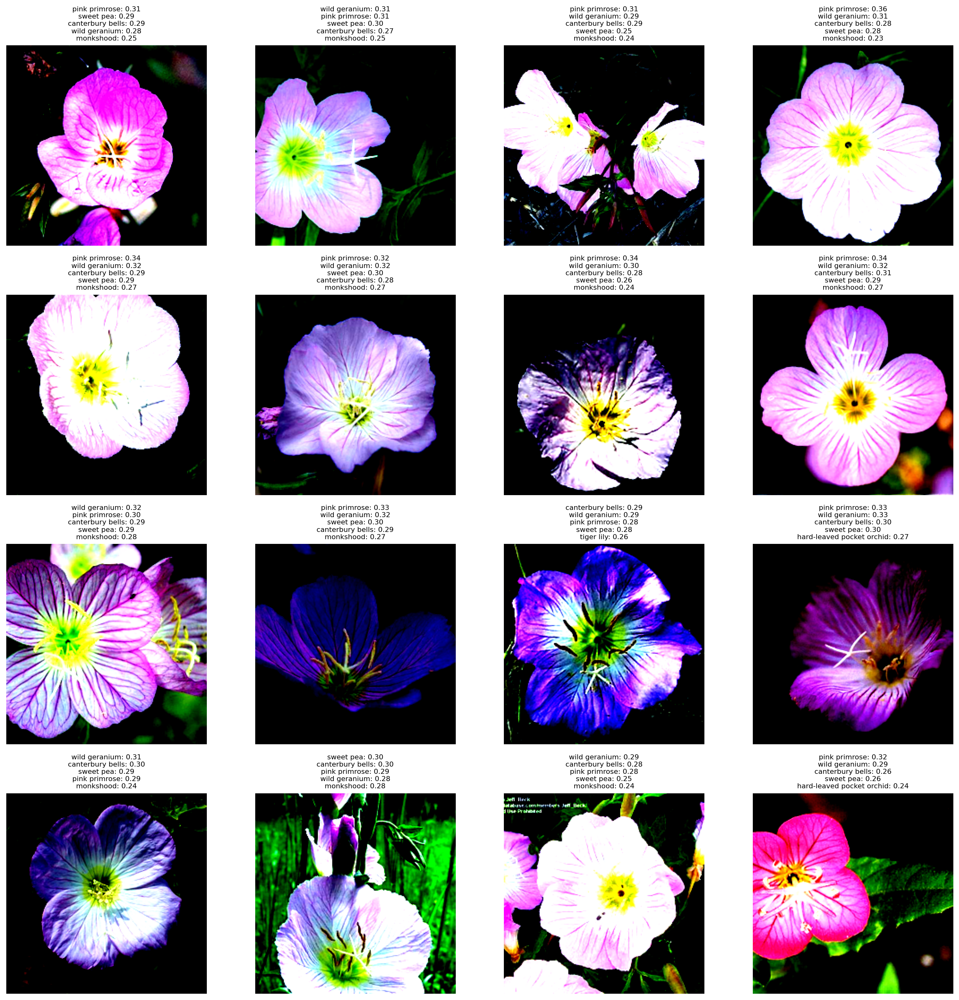

In [69]:

plt.figure(figsize=(16, 16))

for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow(images[i].permute(1, 2, 0).cpu())
    plt.axis("off")

    top5 = similarity[:, i].argsort()[-5:][::-1]
    title = "\n".join([f"{flower_classes[label]}: {similarity[label, i]:.2f}" for label in top5])
    plt.title(title, fontsize=8)

plt.tight_layout()
plt.show()


In [70]:
correct_top1 = 0
correct_top5 = 0

for i in range(16):
    top1 = similarity[:, i].argmax()
    top5 = similarity[:, i].argsort()[-5:][::-1]

    if top1 == labels[i]:
        correct_top1 += 1
    if labels[i] in top5:
        correct_top5 += 1

accuracy_top1 = correct_top1 / 16
accuracy_top5 = correct_top5 / 16

print(f"Précision Top-1 sur les 16 premières images : {accuracy_top1:.2f}")
print(f"Précision Top-5 sur les 16 premières images : {accuracy_top5:.2f}")


Précision Top-1 sur les 16 premières images : 0.62
Précision Top-5 sur les 16 premières images : 1.00
